<a href="https://colab.research.google.com/github/WilliamShengYangHuang/RC18_Machine_Learning/blob/main/random_walks_with_stable_diffusion.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# A walk through latent space with Stable Diffusion

**Date created:** 2022/09/28 by Ian Stenbit, [fchollet](https://twitter.com/fchollet), [lukewood](https://twitter.com/luke_wood_ml)<br>
**Last modified:** 2024/03/21 by [William Huang](https://profiles.ucl.ac.uk/46251-william-huang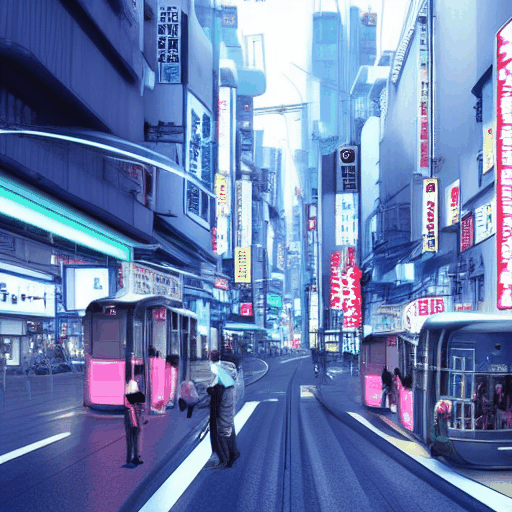)<br>
**Description:** Explore the latent manifold of Stable Diffusion.

## Overview

Generative image models learn a "latent manifold" of the visual world:
a low-dimensional vector space where each point maps to an image.
Going from such a point on the manifold back to a displayable image
is called "decoding" -- in the Stable Diffusion model, this is handled by
the "decoder" model.

![The Stable Diffusion architecture](https://i.imgur.com/2uC8rYJ.png)

This latent manifold of images is continuous and interpolative, meaning that:

1. Moving a little on the manifold only changes the corresponding image a little (continuity).
2. For any two points A and B on the manifold (i.e. any two images), it is possible
to move from A to B via a path where each intermediate point is also on the manifold (i.e.
is also a valid image). Intermediate points would be called "interpolations" between
the two starting images.

Stable Diffusion isn't just an image model, though, it's also a natural language model.
It has two latent spaces: the image representation space learned by the
encoder used during training, and the prompt latent space
which is learned using a combination of pretraining and training-time
fine-tuning.

_Latent space walking_, or _latent space exploration_, is the process of
sampling a point in latent space and incrementally changing the latent
representation. Its most common application is generating animations
where each sampled point is fed to the decoder and is stored as a
frame in the final animation.
For high-quality latent representations, this produces coherent-looking
animations. These animations can provide insight into the feature map of the
latent space, and can ultimately lead to improvements in the training
process. One such GIF is displayed below:

![Panda to Plane](/img/examples/generative/random_walks_with_stable_diffusion/panda2plane.gif)

In this guide, we will show how to take advantage of the Stable Diffusion API
in KerasCV to perform prompt interpolation and circular walks through
Stable Diffusion's visual latent manifold, as well as through
the text encoder's latent manifold.

This guide assumes the reader has a
high-level understanding of Stable Diffusion.
If you haven't already, you should start
by reading the [Stable Diffusion Tutorial](https://keras.io/guides/keras_cv/generate_images_with_stable_diffusion/).

To start, we import KerasCV and load up a Stable Diffusion model using the
optimizations discussed in the tutorial
[Generate images with Stable Diffusion](https://keras.io/guides/keras_cv/generate_images_with_stable_diffusion/).
Note that if you are running with a M1 Mac GPU you should not enable mixed precision.

In [1]:
!pip install tensorflow keras_cv --upgrade --quiet

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 589.8/589.8 MB 1.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 613.1/613.1 kB 2.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.8/4.8 MB 1.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 1.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 1.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 2.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 950.8/950.8 kB 1.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 286.8/286.8 kB 1.2 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tf-keras 2.15.1 requires tensorflow<2.16,>=2.15, but you have tensorflow 2.16.1 which is incompatible.


In [2]:
import keras_cv
from tensorflow import keras
import matplotlib.pyplot as plt
import tensorflow as tf
import numpy as np
import math
from PIL import Image

# Enable mixed precision
# (only do this if you have a recent NVIDIA GPU)
keras.mixed_precision.set_global_policy("mixed_float16")

# Instantiate the Stable Diffusion model
model = keras_cv.models.StableDiffusion(jit_compile=True)

By using this model checkpoint, you acknowledge that its usage is subject to the terms of the CreativeML Open RAIL-M license at https://raw.githubusercontent.com/CompVis/stable-diffusion/main/LICENSE


## Define comment methods

In [18]:
fps = 60 #@param{type:'slider', min:5, max:60, step:5}
rubber_band = False #@param{type:'boolean'}

def export_as_gif(filename, images, frames_per_second=fps, rubber_band=rubber_band):
    if rubber_band:
        images += images[2:-1][::-1]
    images[0].save(
        filename,
        save_all=True,
        append_images=images[1:],
        duration=1000 // frames_per_second,
        loop=0,
    )

In [11]:

fps = 60 #@param{type:'slider', min:5, max:60, step:5}
rubber_band = True #@param{type:'boolean'}

from google.colab import drive
drive.mount('/content/drive')

def export_as_gif_to_drive(filename, images, frames_per_second=10, rubber_band=False):
    if rubber_band:
        images += images[2:-1][::-1]
    images[0].save(
        '/content/drive/My Drive/' + filename,  # Save to Google Drive
        save_all=True,
        append_images=images[1:],
        duration=1000 // frames_per_second,
        loop=0,
    )


Mounted at /content/drive


In [5]:
def git_filepath(file_name):
    file_format = ".gif"
    saving_dir = f"{file_name}{file_format}"
    return saving_dir

## Set Noise

In [14]:
# Note that in order to maintain some stability between the resulting images we
# keep the diffusion noise constant between images.

seed = 13579 #@param{type:'integer'}
noise = tf.random.normal((512 // 8, 512 // 8, 4), seed=seed)





---



## Interpolating between text prompts

In Stable Diffusion, a text prompt is first encoded into a vector,
and that encoding is used to guide the diffusion process.
The latent encoding vector has shape
77x768 (that's huge!), and when we give Stable Diffusion a text prompt, we're
generating images from just one such point on the latent manifold.

To explore more of this manifold, we can interpolate between two text encodings
and generate images at those interpolated points:

In [3]:
prompt_1 = "Render a photo-realistic image of Edo period Tokyo. Picture bustling streets, wooden houses, samurai, merchants, and the distant Edo Castle under Mount Fuji." #@param{type:'string'}
prompt_2 = "Visualise a photo-realistic Tokyo street in 2050. Futuristic skyscrapers, neon lights, high-speed levitating trains, and people with wearable tech gadgets." #@param{type:'string'}

interpolation_steps = 8

encoding_1 = tf.squeeze(model.encode_text(prompt_1))
encoding_2 = tf.squeeze(model.encode_text(prompt_2))

interpolated_encodings = tf.linspace(encoding_1, encoding_2, interpolation_steps)

# Show the size of the latent manifold
print(f"Encoding shape: {encoding_1.shape}")

1356917/1356917 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
492466864/492466864 ━━━━━━━━━━━━━━━━━━━━ 2s 0us/step
Encoding shape: (77, 768)


Note: The `interpolation_steps` parameter controls the number of interpolation steps from encoding_1 to encoding_2. The larger the value of interpolation_steps, the more intermediate frames will be in the generated image sequence, and the transition will be smoother.

In [ ]:
images = model.generate_image(
    interpolated_encodings,
    batch_size=interpolation_steps,
    diffusion_noise=noise,
)

Now that we've generated some interpolated images, let's take a look at them!

Throughout this tutorial, we're going to export sequences of images as gifs so
that they can be easily viewed with some temporal context. For sequences of
images where the first and last images don't match conceptually, we rubber-band
the gif.


In [ ]:
export_as_gif(
    "tokyo-8.gif",
    [Image.fromarray(img) for img in images],
    frames_per_second=2,
    rubber_band=True,
)

from IPython.display import Image as IImage
IImage("tokyo-8.gif")

In [ ]:
interpolation_steps = 150
batch_size = 3
batches = interpolation_steps // batch_size

interpolated_encodings = tf.linspace(encoding_1, encoding_2, interpolation_steps)
batched_encodings = tf.split(interpolated_encodings, batches)

images = []
for batch in range(batches):
    images += [
        Image.fromarray(img)
        for img in model.generate_image(
            batched_encodings[batch],
            batch_size=batch_size,
            num_steps=25,
            diffusion_noise=noise,
        )
    ]

export_as_gif("tokyo-8.gif.gif", images, rubber_band=True)

The resulting gif shows a much clearer and more coherent shift between the two
prompts. Try out some prompts of your own and experiment!

We can even extend this concept for more than one image. For example, we can
interpolate between four prompts:

In [ ]:
"""
prompt_1 = "A watercolor painting of a Golden Retriever at the beach"
prompt_2 = "A still life DSLR photo of a bowl of fruit"
prompt_3 = "The eiffel tower in the style of starry night"
prompt_4 = "An architectural sketch of a skyscraper"

interpolation_steps = 6
batch_size = 3
batches = (interpolation_steps**2) // batch_size

encoding_1 = tf.squeeze(model.encode_text(prompt_1))
encoding_2 = tf.squeeze(model.encode_text(prompt_2))
encoding_3 = tf.squeeze(model.encode_text(prompt_3))
encoding_4 = tf.squeeze(model.encode_text(prompt_4))

interpolated_encodings = tf.linspace(
    tf.linspace(encoding_1, encoding_2, interpolation_steps),
    tf.linspace(encoding_3, encoding_4, interpolation_steps),
    interpolation_steps,
)
interpolated_encodings = tf.reshape(
    interpolated_encodings, (interpolation_steps**2, 77, 768)
)
batched_encodings = tf.split(interpolated_encodings, batches)

images = []
for batch in range(batches):
    images.append(
        model.generate_image(
            batched_encodings[batch],
            batch_size=batch_size,
            diffusion_noise=noise,
        )
    )


def plot_grid(
    images,
    path,
    grid_size,
    scale=2,
):
    fig = plt.figure(figsize=(grid_size * scale, grid_size * scale))
    fig.tight_layout()
    plt.subplots_adjust(wspace=0, hspace=0)
    plt.margins(x=0, y=0)
    plt.axis("off")
    images = images.astype(int)
    for row in range(grid_size):
        for col in range(grid_size):
            index = row * grid_size + col
            plt.subplot(grid_size, grid_size, index + 1)
            plt.imshow(images[index].astype("uint8"))
            plt.axis("off")
            plt.margins(x=0, y=0)
    plt.savefig(
        fname=path,
        pad_inches=0,
        bbox_inches="tight",
        transparent=False,
        dpi=60,
    )


images = np.concatenate(images)
plot_grid(images, "4-way-interpolation.jpg", interpolation_steps)
"""

We can also interpolate while allowing diffusion noise to vary by dropping
the `diffusion_noise` parameter:

In [ ]:
images = []
for batch in range(batches):
    images.append(model.generate_image(batched_encodings[batch], batch_size=batch_size))

images = np.concatenate(images)
plot_grid(images, "4-way-interpolation-varying-noise.jpg", interpolation_steps)

Next up -- let's go for some walks!

## A walk around a text prompt

Our next experiment will be to go for a walk around the latent manifold
starting from a point produced by a particular prompt.

In [15]:
walk_steps = 90 #@param{type:'integer'}
batch_size = 3
batches = walk_steps // batch_size
step_size = 0.005
num_steps = 25 #@param{type:'slider', min:0, max:100, step:5}

text_prompt = "Visualise a photo-realistic Tokyo street in 2050. Futuristic skyscrapers, neon lights, high-speed levitating trains, and people with wearable tech gadgets." #@param{type:'string'}
encoding = tf.squeeze(
    model.encode_text(text_prompt)
)
# Note that (77, 768) is the shape of the text encoding.
delta = tf.ones_like(encoding) * step_size

walked_encodings = []
for step_index in range(walk_steps):
    walked_encodings.append(encoding)
    encoding += delta
walked_encodings = tf.stack(walked_encodings)
batched_encodings = tf.split(walked_encodings, batches)

images = []
for batch in range(batches):
    images += [
        Image.fromarray(img)
        for img in model.generate_image(
            batched_encodings[batch],
            batch_size=batch_size,
            num_steps=num_steps,
            diffusion_noise=noise,
        )
    ]

25/25 ━━━━━━━━━━━━━━━━━━━━ 619s 25s/step
25/25 ━━━━━━━━━━━━━━━━━━━━ 574s 23s/step
25/25 ━━━━━━━━━━━━━━━━━━━━ 572s 23s/step
25/25 ━━━━━━━━━━━━━━━━━━━━ 578s 23s/step
25/25 ━━━━━━━━━━━━━━━━━━━━ 581s 23s/step
25/25 ━━━━━━━━━━━━━━━━━━━━ 588s 24s/step
25/25 ━━━━━━━━━━━━━━━━━━━━ 597s 24s/step
25/25 ━━━━━━━━━━━━━━━━━━━━ 583s 23s/step
25/25 ━━━━━━━━━━━━━━━━━━━━ 591s 24s/step
25/25 ━━━━━━━━━━━━━━━━━━━━ 586s 23s/step
25/25 ━━━━━━━━━━━━━━━━━━━━ 597s 24s/step
25/25 ━━━━━━━━━━━━━━━━━━━━ 621s 25s/step
25/25 ━━━━━━━━━━━━━━━━━━━━ 694s 28s/step
25/25 ━━━━━━━━━━━━━━━━━━━━ 663s 26s/step
25/25 ━━━━━━━━━━━━━━━━━━━━ 622s 25s/step
25/25 ━━━━━━━━━━━━━━━━━━━━ 623s 25s/step
25/25 ━━━━━━━━━━━━━━━━━━━━ 626s 25s/step
25/25 ━━━━━━━━━━━━━━━━━━━━ 623s 25s/step
25/25 ━━━━━━━━━━━━━━━━━━━━ 630s 25s/step
25/25 ━━━━━━━━━━━━━━━━━━━━ 623s 25s/step
25/25 ━━━━━━━━━━━━━━━━━━━━ 631s 25s/step
25/25 ━━━━━━━━━━━━━━━━━━━━ 631s 25s/step
25/25 ━━━━━━━━━━━━━━━━━━━━ 628s 25s/step
25/25 ━━━━━━━━━━━━━━━━━━━━ 624s 25s/step
25/25 ━━━━━━━━━━

Output animated GIF

In [19]:
file_name = 'future_ct.gif' #@param{type:'string'}
export_as_gif(file_name, images, rubber_band=True)

In [17]:
export_as_gif_to_drive(file_name, images, rubber_band=True)

In [ ]:
from IPython.display import Image as IImage
IImage(file_name)

In [20]:
prompt = "Visualise a photo-realistic Tokyo street in 2050. Futuristic skyscrapers, neon lights, high-speed levitating trains, and people with wearable tech gadgets." #@param{type:'string'}
encoding = tf.squeeze(model.encode_text(prompt))
walk_steps = 30 #@param{type:'integer'}
batch_size = 3
batches = walk_steps // batch_size
num_steps = 25 #@param{type:'slider', min:0, max:100, step:5}

walk_noise_x = tf.random.normal(noise.shape, dtype=tf.float64)
walk_noise_y = tf.random.normal(noise.shape, dtype=tf.float64)

walk_scale_x = tf.cos(tf.linspace(0, 2, walk_steps) * math.pi)
walk_scale_y = tf.sin(tf.linspace(0, 2, walk_steps) * math.pi)
noise_x = tf.tensordot(walk_scale_x, walk_noise_x, axes=0)
noise_y = tf.tensordot(walk_scale_y, walk_noise_y, axes=0)
noise = tf.add(noise_x, noise_y)
batched_noise = tf.split(noise, batches)

images = []
for batch in range(batches):
    images += [
        Image.fromarray(img)
        for img in model.generate_image(
            encoding,
            batch_size=batch_size,
            num_steps=num_steps,
            diffusion_noise=batched_noise[batch],
        )
    ]

export_as_gif("walk_around.gif", images)

25/25 ━━━━━━━━━━━━━━━━━━━━ 678s 25s/step
25/25 ━━━━━━━━━━━━━━━━━━━━ 625s 25s/step
25/25 ━━━━━━━━━━━━━━━━━━━━ 624s 25s/step
25/25 ━━━━━━━━━━━━━━━━━━━━ 623s 25s/step
25/25 ━━━━━━━━━━━━━━━━━━━━ 624s 25s/step
25/25 ━━━━━━━━━━━━━━━━━━━━ 621s 25s/step
25/25 ━━━━━━━━━━━━━━━━━━━━ 632s 25s/step
25/25 ━━━━━━━━━━━━━━━━━━━━ 638s 26s/step
25/25 ━━━━━━━━━━━━━━━━━━━━ 631s 25s/step
25/25 ━━━━━━━━━━━━━━━━━━━━ 640s 26s/step


In [21]:
file_name = 'walk_around_2.gif' #@param{type:'string'}
export_as_gif(file_name, images, rubber_band=True)

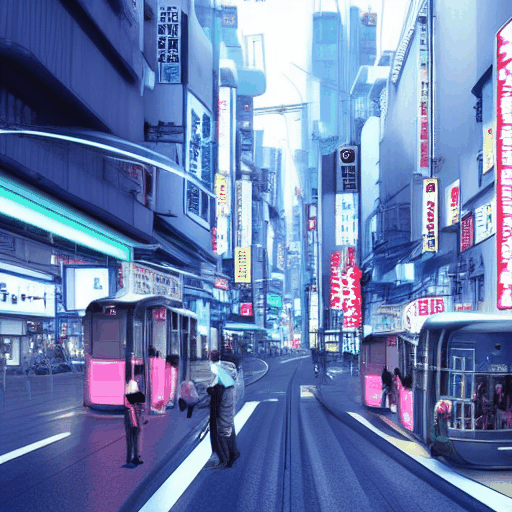

In [22]:
from IPython.display import Image as IImage
IImage(file_name)